## IN-PROGRESS

## **Enzyme Kinetics** : 
#### _Accurate numerical solution_ - compared to the **Michaelis-Menten** model approximation and to the alternative **Morrison** model.

#### Two Coupled Reactions: `E + S <-> ES`, and  `ES -> E + P` , using real-life kinetic parameters.  
#### Scenario with _small amount of Enzyme_, relative to the initial Substrate concentration.

#### Unlike in experiment `enzyme_1_a`, we'll use data from a reaction that VIOLATES the customary Michaelis-Menten assumption that the rate constants satisfy `k1_reverse >> k2_forward`

#### THE REACTION:  
the enzyme `Chymotrypsin` with the substrate `N-CBZ-Gly-Pro-Arg-p-nitroanilide`,  
and the initial concentration values choosen below, all satisfy the customary Michaelis-Menten assumptions that  
`[E] << [S]` BUT the reaction rate constants DON'T satisfy `k1_reverse >> k2_forward`

For this reaction: k1_forward = 1.4 × 10^-6, k1_reverse = 6.8, k2_forward = 110.  

Source of kinetic parameters:  *page 16 of "Analysis of Enzyme Reaction Kinetics, Vol. 1", by F. Xavier Malcata, Wiley, 2023*

### TAGS :  "uniform compartment", "chemistry", "numerical", "enzymes"

In [1]:
LAST_REVISED = "Nov. 5, 2024"
LIFE123_VERSION = "1.0.0.rc.0"      # Library version this experiment is based on

In [2]:
#import set_path                    # Using MyBinder?  Uncomment this before running the next cell!

In [3]:
#import sys
#sys.path.append("C:/some_path/my_env_or_install")   # CHANGE to the folder containing your venv or libraries installation!
# NOTE: If any of the imports below can't find a module, uncomment the lines above, or try:  import set_path   

import ipynbname
import pandas as pd

from life123 import check_version, ChemData, UniformCompartment, ReactionEnz, PlotlyHelper

In [4]:
check_version(LIFE123_VERSION)

OK


# 1. Accurate numerical solution

In [5]:
chem_data = ChemData(names=["P", "ES"])

In [6]:
# Our Enzyme
chem_data.add_chemical(name="Aminopeptidase", label="E") 

# Our Substrate
chem_data.add_chemical(name="Leu-Ala-DED", label="S");

In [7]:
chem_data.all_chemicals()

,name,label
0,P,P
1,ES,ES
2,Aminopeptidase,E
3,Leu-Ala-DED,S


### Specify the Kinetic Parameters

Source: *page 16 of "Analysis of Enzyme Reaction Kinetics, Vol. 1", by F. Xavier Malcata, Wiley, 2023*

In [8]:
# Reaction E + S <-> ES , with 1st-order kinetics, 
chem_data.add_reaction(reactants=["E", "S"], products=["ES"],
                       forward_rate=160., reverse_rate=0.089) 

# Reaction ES <-> E + P , with 1st-order kinetics, ignoring the reverse reaction
chem_data.add_reaction(reactants=["ES"], products=["E", "P"],
                       forward_rate=0.58, reverse_rate=0)  

chem_data.describe_reactions()

Number of reactions: 2 (at temp. 25 C)
0: E + S <-> ES  (kF = 160 / kR = 0.089 / delta_G = -18,578 / K = 1,797.8) | 1st order in all reactants & products
1: ES <-> E + P  (kF = 0.58 / kR = 0) | 1st order in all reactants & products
Set of chemicals involved in the above reactions: {'E', 'ES', 'P', 'S'}


## Set the initial concentrations of all the chemicals
### in the scenario we're exploring, there's LITTLE ENZYME relative to initial substrate concentration

In [9]:
S0 = 20.
E0 = 1.

In [10]:
# Here we use the "slower" preset for the variable steps, a conservative option prioritizing accuracy over speed
uc = UniformCompartment(chem_data=chem_data, preset="mid")
uc.set_conc(conc={"S": S0, "E": E0})      # Small ampount of enzyme `E`, relative to substrate `S`
uc.describe_state()

SYSTEM STATE at Time t = 0:
4 species:
  Species 0 (P). Conc: 0.0
  Species 1 (ES). Conc: 0.0
  Species 2 (E). Conc: 1.0
  Species 3 (S). Conc: 20.0
Set of chemicals involved in reactions: {'E', 'ES', 'P', 'S'}


In [11]:
uc.enable_diagnostics()   # To save diagnostic information about the simulation - in particular, the REACTION RATES

#### Advance the reactions to equilibrium

In [12]:
# Perform the reactions
uc.single_compartment_react(duration=3., initial_step=0.00001)

14068 total step(s) taken
Number of step re-do's because of negative concentrations: 1831
Norm usage: {'norm_A': 13950, 'norm_B': 13952, 'norm_C': 13950, 'norm_D': 13950}


plot_pandas() NOTICE: Excessive number of vertical lines (14069) - only showing 1 every 94 lines


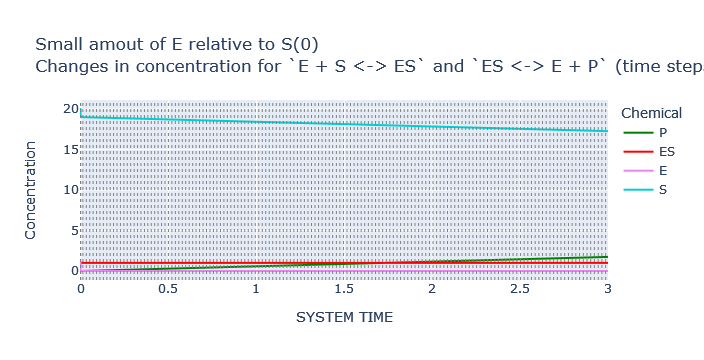

In [13]:
uc.plot_history(colors=['green', 'red', 'violet', 'darkturquoise'], show_intervals=True, 
                title_prefix="Small amout of E relative to S(0)")

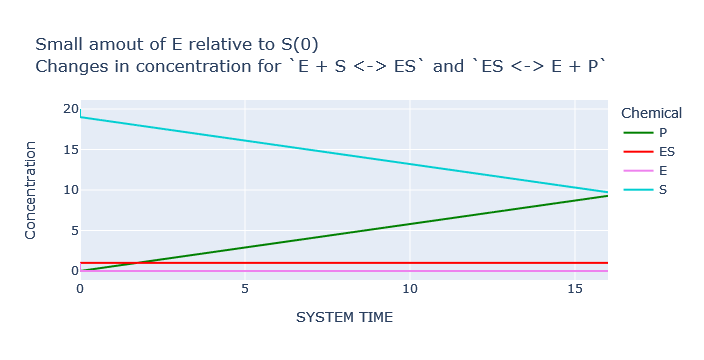

In [25]:
uc.plot_history(colors=['green', 'red', 'violet', 'darkturquoise'],
                title_prefix="Small amout of E relative to S(0)")

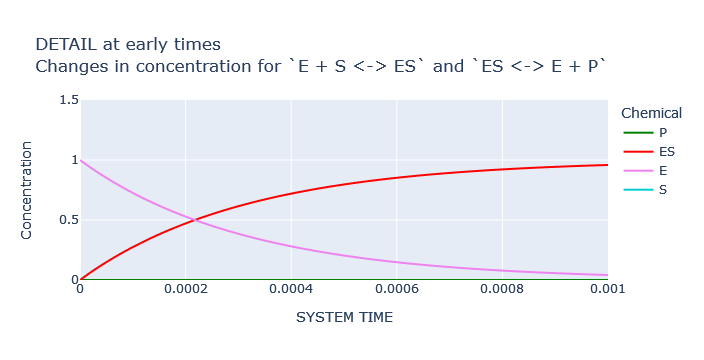

In [16]:
# Highlight a detail about the initial buildup of ES
uc.plot_history(colors=['green', 'red', 'violet', 'darkturquoise'], title_prefix="DETAIL at early times",
                range_x=[0, 0.001], range_y=[0, 1.5])

#### Notice how the bound enzyme `ES` (green) quickly builds up at the very beginning, from time 0 to roughly 0.01 ... and that, in the longer term, the enzyme returns to its unbound state `E`

In [19]:
# Perform the reactions
uc.single_compartment_react(duration=5., initial_step=0.001)

Some steps were backtracked and re-done, to prevent negative concentrations or excessively large concentration changes
18039 total step(s) taken
Number of step re-do's because of negative concentrations: 2373
Norm usage: {'norm_A': 18039, 'norm_B': 18039, 'norm_C': 18039, 'norm_D': 18039}


In [21]:
uc.adaptive_steps.show_adaptive_parameters()

Parameters used for the automated adaptive time step sizes -
    THRESHOLDS:  [{'norm': 'norm_A', 'low': 0.5, 'high': 0.8, 'abort': 1.44}, {'norm': 'norm_B', 'low': 0.08, 'high': 0.5, 'abort': 1.5}]
    STEP FACTORS:  {'upshift': 1.2, 'downshift': 0.5, 'abort': 0.4, 'error': 0.25}


In [22]:
uc.adaptive_steps.use_adaptive_preset("slow")

In [23]:
uc.adaptive_steps.show_adaptive_parameters()

Parameters used for the automated adaptive time step sizes -
    THRESHOLDS:  [{'norm': 'norm_A', 'low': 0.2, 'high': 0.5, 'abort': 0.8}, {'norm': 'norm_B', 'low': 0.05, 'high': 0.4, 'abort': 1.3}]
    STEP FACTORS:  {'upshift': 1.1, 'downshift': 0.3, 'abort': 0.2, 'error': 0.1}


In [24]:
# Perform the reactions
uc.single_compartment_react(duration=5., initial_step=0.001)

Some steps were backtracked and re-done, to prevent negative concentrations or excessively large concentration changes
19823 total step(s) taken
Number of step re-do's because of negative concentrations: 821
Norm usage: {'norm_A': 19823, 'norm_B': 19823, 'norm_C': 19823, 'norm_D': 19823}


### What is the initial rate of production of the final reaction product `P`?   
One could take the numerical derivative (gradient) of the time values of [P] - but no need to!  **Reaction rates are computed in the course of the simulation, and stored alongside other diagnostic data**, provided that diagnostics were enabled (as we did indeed enable)

In [ ]:
rates = uc.get_diagnostics().get_system_history_with_rxn_rates(rxn_index=1)   # We specify the reaction that involves `P`
rates

In [ ]:
# Let's take a look at how the reaction rate varies with time
PlotlyHelper.plot_pandas(df=rates, 
                         title="Reaction rate, dP/dt, over time",
                         x_var="TIME", fields="rate", 
                         x_label="time", y_label="dP/dt")

In [ ]:
# A closer peek at it maximum value
PlotlyHelper.plot_pandas(df=rates, 
                         title="Reaction rate, dP/dt, over time (DETAIL at early times)",
                         x_var="TIME", fields="rate", 
                         x_label="time", y_label="dP/dt",
                         range_x=[0,0.05], range_y=[33., 34.5])

As we saw earlier, the time it took for `ES` to build up was about 0.01  
**Ignoring the brief initial transient phase, the reaction rate starts at about 34.1**

# 2. Comparing the results to the Michaelis-Menten model approximation

### Let's compute some parameters used by the Michaelis-Menten model   
for background reference, see:  https://vallance.chem.ox.ac.uk/pdfs/KineticsLectureNotes.pdf (p. 20)

In [ ]:
rxn = ReactionEnz(enzyme="E", substrate="S", product="P",
                  k1_F=chem_data.get_forward_rate(0), k1_R=chem_data.get_reverse_rate(0), 
                  k2_F=chem_data.get_forward_rate(1))

In [ ]:
rxn.kM          #  For the data in this experiment, it comes out to (49. + 100.) / 18.

In [ ]:
rxn.kcat

In [ ]:
vmax = rxn.compute_vmax(E_tot=E0)          # kcat * E0
vmax

In [ ]:
initial_rxn_rate = rxn.compute_rate(S_conc=S0)    #  (vmax * S0) / (kM + S0)
initial_rxn_rate

Not too far from the value of about 34.1 we saw earlier...   
To keep in mind that the initial part of the reaction is affected by transients

### Now, let's look at rate as a function of [S]; we'll compare what we computed earlier vs. what is given by the approximation of the Michaelis-Menten model

In [ ]:
# Let's add a column with the rate estimated by the Michaelis-Menten model
rates["Michaelis_rate"] = rxn.compute_rate(S_conc=rates["S"])
rates

In [ ]:
# Let's see how our computed rate compares with the approximations from the Michaelis-Menten model
PlotlyHelper.plot_pandas(df=rates, x_var="S", fields=["rate", "Michaelis_rate"],
                         title="Reaction rate, dP/dt, as a function of Substrate concentration",
                         y_label="dP/dt", legend_header="Rates",
                         vertical_lines_to_add=18.9)

Let's recall that our reactions started with [S]=20  
Virtually overlapped plots, except at the very right! (very early times, when [S] is greater than about 19)

## In this scenario, the Michaelis-Menten model is remarkable accurate EXCEPT at the very early times of the reaction (the large values of `S`), which is the brief initial transient phase when `ES` builds up from zero

#### This is as expected, because the kinetic parameters of this reaction satisfy the Michaelis-Menten assumptions that `[E] << [S]` and that the rates satisfy `k1_reverse >> k2_forward`

# 3. Comparing the results to the Morrison model

#### Following section 7.1 of _"Analysis of Enzyme Reaction Kinetics, Vol. 1", by F. Xavier Malcata, Wiley, 2023_ , we'll test out an the alternative **Morrison** approach, which is expected to perform better than the **Michaelis-Menten** model when the Enzyme concentration isn't so small.  But, in this scenario, we only have small amounts of enzyme - and we'll see below that no significant improvement is gained by switching model.

In [ ]:
rates["Morrison_rate"] = rxn.compute_rate_morrison(E_tot=E0,
                                                   S_tot=rates["S"] + rates["ES"])
rates

In [ ]:
PlotlyHelper.plot_pandas(df=rates, x_var="S", fields=["rate", "Michaelis_rate", "Morrison_rate"],
                         title="Reaction rate, dP/dt, as a function of Substrate concentration",
                         y_label="dP/dt", legend_header="Rates",
                         vertical_lines_to_add=18.9,
                         colors=["green", "blue", "purple"])

## The Morrison model appears to be only very mildly better than the Michaelis-Menten one at the early reaction times - and virtually identical later on.  
Then why even bother with it?  In the next two experiments, `enzyme_2` and `enzyme_3`, we'll see how the Morrison model becomes progressively better than Michaelis-Menten at increasingly higher amounts of enzyme.